In [9]:
import folium
from folium import plugins
import requests
import json
from collections import defaultdict
import time

print("Libraries imported successfully!")

Libraries imported successfully!


In [10]:
# Tashkent coordinates
TASHKENT_CENTER = [41.2995, 69.2401]

# Define functionality categories based on OSM amenity tags
FUNCTIONALITY_CATEGORIES = {
    'Commercial': ['shop', 'marketplace', 'mall', 'supermarket', 'store'],
    'Food & Dining': ['restaurant', 'cafe', 'fast_food', 'bar', 'pub'],
    'Healthcare': ['hospital', 'clinic', 'pharmacy', 'doctors', 'dentist'],
    'Education': ['school', 'university', 'college', 'kindergarten', 'library'],
    'Transportation': ['bus_station', 'taxi', 'parking', 'fuel', 'car_rental'],
    'Public Services': ['bank', 'atm', 'post_office', 'police', 'fire_station'],
    'Recreation': ['park', 'cinema', 'theatre', 'museum', 'sports_centre'],
    'Religious': ['place_of_worship', 'mosque', 'church', 'temple']
}

# Color scheme for categories
CATEGORY_COLORS = {
    'Commercial': 'blue',
    'Food & Dining': 'orange',
    'Healthcare': 'red',
    'Education': 'green',
    'Transportation': 'purple',
    'Public Services': 'darkblue',
    'Recreation': 'pink',
    'Religious': 'lightgray'
}

In [7]:
def fetch_osm_data(bbox, amenity_type):
    """Fetch OSM data using Overpass API"""
    overpass_url = "http://overpass-api.de/api/interpreter"

    # Overpass QL query
    query = f"""
    [out:json][timeout:25];
    (
      node["amenity"="{amenity_type}"]({bbox[0]},{bbox[1]},{bbox[2]},{bbox[3]});
      way["amenity"="{amenity_type}"]({bbox[0]},{bbox[1]},{bbox[2]},{bbox[3]});
    );
    out center;
    """

    try:
        response = requests.get(overpass_url, params={'data': query}, timeout=30)
        if response.status_code == 200:
            return response.json()
        else:
            print(f"Warning: Status {response.status_code} for {amenity_type}")
            return {'elements': []}
    except Exception as e:
        print(f"Error fetching {amenity_type}: {str(e)}")
        return {'elements': []}

print("Configuration loaded successfully!")

Configuration loaded successfully!


In [11]:
def get_location_data():
    """Fetch locations for all categories in Tashkent"""
    # Bounding box for Tashkent (south, west, north, east)
    bbox = [41.15, 69.10, 41.45, 69.40]

    locations_by_category = defaultdict(list)

    print("Fetching OSM data for Tashkent...\n")
    print("=" * 60)

    for category, amenity_types in FUNCTIONALITY_CATEGORIES.items():
        print(f"Fetching {category}...", end=" ")
        category_count = 0

        for amenity in amenity_types:
            data = fetch_osm_data(bbox, amenity)

            for element in data.get('elements', []):
                if 'lat' in element and 'lon' in element:
                    lat, lon = element['lat'], element['lon']
                elif 'center' in element:
                    lat, lon = element['center']['lat'], element['center']['lon']
                else:
                    continue

                name = element.get('tags', {}).get('name', amenity.replace('_', ' ').title())

                locations_by_category[category].append({
                    'lat': lat,
                    'lon': lon,
                    'name': name,
                    'type': amenity
                })
                category_count += 1

            # Small delay to avoid overwhelming the API
            time.sleep(0.5)

        print(f"Found {category_count} locations")

    print("=" * 60)
    return locations_by_category

# Fetch the data
locations_data = get_location_data()

# Print statistics
print("\nStatistics Summary:")
print("=" * 60)
total = 0
for category, locs in locations_data.items():
    count = len(locs)
    total += count
    print(f"  {category}: {count} locations")
print("=" * 60)
print(f"  Total locations: {total}")
print("=" * 60)

Fetching OSM data for Tashkent...

Fetching Commercial... Found 94 locations
Fetching Food & Dining... Found 2631 locations
Fetching Healthcare... Found 1869 locations
Fetching Education... Found 1255 locations
Fetching Transportation... Found 2163 locations
Fetching Public Services... Found 1454 locations
Fetching Recreation... Found 45 locations
Fetching Religious... Found 278 locations

Statistics Summary:
  Commercial: 94 locations
  Food & Dining: 2631 locations
  Healthcare: 1869 locations
  Education: 1255 locations
  Transportation: 2163 locations
  Public Services: 1454 locations
  Recreation: 45 locations
  Religious: 278 locations
  Total locations: 9789


In [19]:
# First, let's verify we have data
print("Verifying data...")
for cat, locs in locations_data.items():
    if locs:
        print(f"{cat}: {len(locs)} locations (sample: {locs[0]})")
        break

# Create base map
print("\nCreating map...")
m = folium.Map(
    location=TASHKENT_CENTER,
    zoom_start=12,
    tiles='OpenStreetMap'
)

# Add a simple test marker first to verify map works
folium.Marker(
    location=TASHKENT_CENTER,
    popup="Tashkent Center",
    icon=folium.Icon(color='red', icon='star')
).add_to(m)

print("Test marker added at center")

# Now add all the real data
total_added = 0
for category, locations in locations_data.items():
    if not locations:
        continue

    print(f"\nProcessing {category}: {len(locations)} locations")

    # Create marker cluster for this category
    marker_cluster = plugins.MarkerCluster(name=f'{category}')

    count = 0
    for loc in locations:
        try:
            lat = float(loc['lat'])
            lon = float(loc['lon'])

            # Simple marker without complex popup
            folium.Marker(
                location=[lat, lon],
                popup=str(loc.get('name', 'Unknown')),
                icon=folium.Icon(color=CATEGORY_COLORS.get(category, 'gray'))
            ).add_to(marker_cluster)

            count += 1
            total_added += 1

        except Exception as e:
            continue

    print(f"  Added {count} markers")
    marker_cluster.add_to(m)

print(f"\n✓ Total markers added to map: {total_added}")

# Save to variable
tashkent_map = m

Verifying data...
Commercial: 94 locations (sample: {'lat': 41.329195, 'lon': 69.2492772, 'name': 'Базарчик', 'type': 'marketplace'})

Creating map...
Test marker added at center

Processing Commercial: 94 locations
  Added 94 markers

Processing Food & Dining: 2631 locations
  Added 2631 markers

Processing Healthcare: 1869 locations
  Added 1869 markers

Processing Education: 1255 locations
  Added 1255 markers

Processing Transportation: 2163 locations
  Added 2163 markers

Processing Public Services: 1454 locations
  Added 1454 markers

Processing Recreation: 45 locations
  Added 45 markers

Processing Religious: 278 locations
  Added 278 markers

✓ Total markers added to map: 9789


In [20]:
tashkent_map

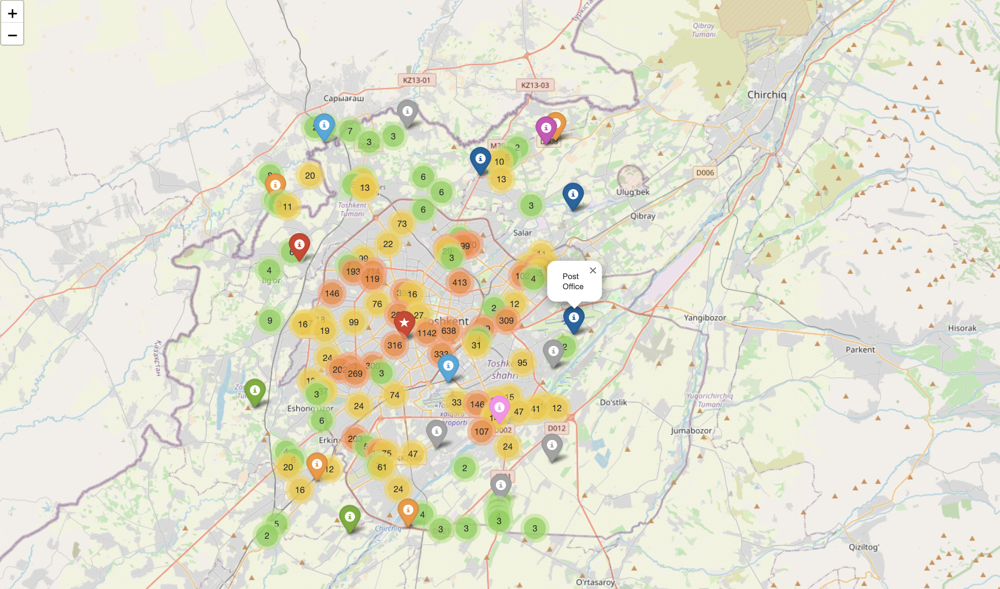

In [30]:
def create_heatmap(locations_by_category):
    """Create heatmap for each category with unique colors"""
    print("\nCreating heatmap visualization...")

    m = folium.Map(
        location=TASHKENT_CENTER,
        zoom_start=11,
        tiles='CartoDB dark_matter'
    )

    # Define color gradients for each category (more transparent, sharper)
    category_gradients = {
        'Commercial': {0.0: 'rgba(0,102,255,0)', 0.5: 'rgba(0,153,255,0.5)', 1.0: 'rgba(0,204,255,0.8)'},  # Blues
        'Food & Dining': {0.0: 'rgba(255,102,0,0)', 0.5: 'rgba(255,153,51,0.5)', 1.0: 'rgba(255,204,0,0.8)'},  # Oranges
        'Healthcare': {0.0: 'rgba(204,0,0,0)', 0.5: 'rgba(255,51,51,0.5)', 1.0: 'rgba(255,102,102,0.8)'},  # Reds
        'Education': {0.0: 'rgba(0,204,0,0)', 0.5: 'rgba(51,255,51,0.5)', 1.0: 'rgba(102,255,102,0.8)'},  # Greens
        'Transportation': {0.0: 'rgba(102,0,204,0)', 0.5: 'rgba(153,51,255,0.5)', 1.0: 'rgba(204,102,255,0.8)'},  # Purples
        'Public Services': {0.0: 'rgba(0,0,102,0)', 0.5: 'rgba(0,0,204,0.5)', 1.0: 'rgba(51,51,255,0.8)'},  # Dark blues
        'Recreation': {0.0: 'rgba(204,0,204,0)', 0.5: 'rgba(255,51,255,0.5)', 1.0: 'rgba(255,102,255,0.8)'}  # Pinks
    }

    # Add heatmap for each category with unique color
    for category, locations in locations_by_category.items():
        if not locations:
            continue

        print(f"  Adding heatmap for {category}: {len(locations)} points")

        # Prepare data for heatmap
        heat_data = [[loc['lat'], loc['lon']] for loc in locations]

        # Get gradient for this category
        gradient = category_gradients.get(category, {
            0.0: 'rgba(128,128,128,0)', 0.5: 'rgba(160,160,160,0.5)', 1.0: 'rgba(192,192,192,0.8)'
        })

        # Create heatmap layer with sharper, more transparent settings
        heat_layer = plugins.HeatMap(
            heat_data,
            name=f'{category}',
            min_opacity=0.0,
            max_opacity=0.55,
            radius=10,  # Smaller radius = sharper
            blur=5,    # Less blur = clearer boundaries
            gradient=gradient,
            show=True
        )
        heat_layer.add_to(m)

    # Add layer control
    folium.LayerControl(collapsed=False).add_to(m)

    # Add legend for colors
    legend_html = '''
    <div style="position: fixed;
                top: 10px; right: 10px; width: 180px;
                background-color: rgba(255,255,255,0.95); border:2px solid grey; z-index:9999;
                font-size:12px; padding: 10px; border-radius: 5px; box-shadow: 2px 2px 6px rgba(0,0,0,0.3);">
        <p style="margin:0; font-weight:bold; margin-bottom:8px;">Heatmap Legend</p>
        <p style="margin:3px 0;"><span style="display:inline-block; width:15px; height:15px; background:#00ccff; margin-right:5px;"></span> Commercial</p>
        <p style="margin:3px 0;"><span style="display:inline-block; width:15px; height:15px; background:#ffcc00; margin-right:5px;"></span> Food & Dining</p>
        <p style="margin:3px 0;"><span style="display:inline-block; width:15px; height:15px; background:#ff6666; margin-right:5px;"></span> Healthcare</p>
        <p style="margin:3px 0;"><span style="display:inline-block; width:15px; height:15px; background:#66ff66; margin-right:5px;"></span> Education</p>
        <p style="margin:3px 0;"><span style="display:inline-block; width:15px; height:15px; background:#cc66ff; margin-right:5px;"></span> Transportation</p>
        <p style="margin:3px 0;"><span style="display:inline-block; width:15px; height:15px; background:#3333ff; margin-right:5px;"></span> Public Services</p>
        <p style="margin:3px 0;"><span style="display:inline-block; width:15px; height:15px; background:#ff66ff; margin-right:5px;"></span> Recreation</p>
        <p style="margin:8px 0 3px 0; font-size:10px; font-style:italic;">Toggle layers to see distributions</p>
    </div>
    '''
    m.get_root().html.add_child(folium.Element(legend_html))

    print("✓ Sharper multi-color heatmap created!")
    print("\nTip: Streets and labels now visible through the heatmap")
    print("     Zoom in/out to see detail levels")
    return m

heatmap = create_heatmap(locations_data)

# Display heatmap
print("\nDisplaying Sharper Multi-Color Heatmap:")
heatmap


Creating heatmap visualization...
  Adding heatmap for Commercial: 94 points
  Adding heatmap for Food & Dining: 2631 points
  Adding heatmap for Healthcare: 1869 points
  Adding heatmap for Education: 1255 points
  Adding heatmap for Transportation: 2163 points
  Adding heatmap for Public Services: 1454 points
  Adding heatmap for Recreation: 45 points
  Adding heatmap for Religious: 278 points
✓ Sharper multi-color heatmap created!

Tip: Streets and labels now visible through the heatmap
     Zoom in/out to see detail levels

Displaying Sharper Multi-Color Heatmap:


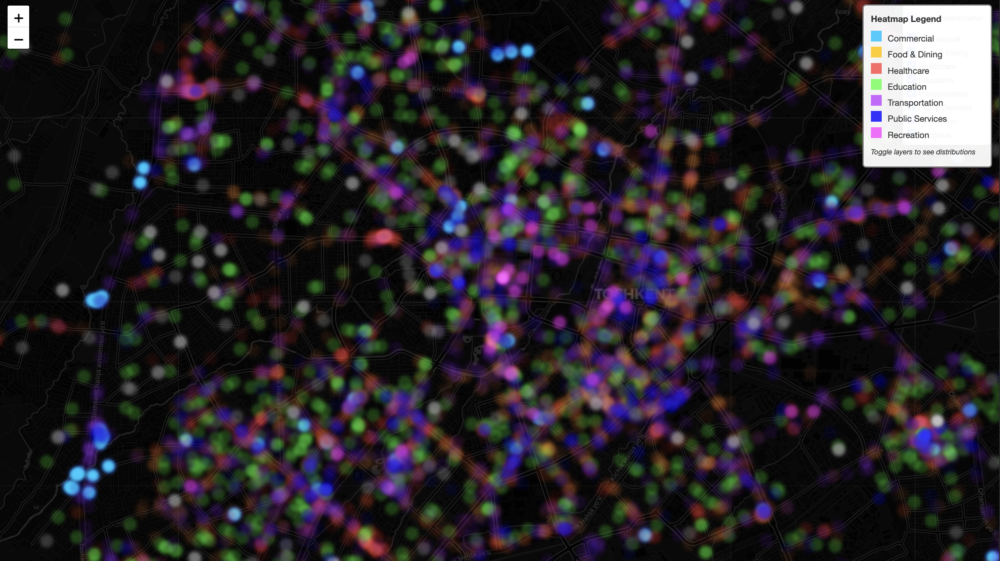

In [50]:
import json
from shapely.geometry import shape, Point
from google.colab import files

# Upload the GeoJSON file
print("Please upload your Tashkent boundaries GeoJSON file...")
uploaded = files.upload()

# Get the uploaded filename
geojson_filename = list(uploaded.keys())[0]
print(f"\nLoaded file: {geojson_filename}")

# Load Tashkent boundary GeoJSON
print("Loading Tashkent city boundaries...")
with open(geojson_filename, 'r', encoding='utf-8') as f:
    tashkent_geojson = json.load(f)

print(f"Loaded {len(tashkent_geojson['features'])} boundary features")

# Create shapely geometries for boundary checking
tashkent_polygons = []
for feature in tashkent_geojson['features']:
    geom = shape(feature['geometry'])
    tashkent_polygons.append(geom)

print(f"Created {len(tashkent_polygons)} polygon boundaries")

# Filter locations to only include those within Tashkent boundaries
def is_point_in_tashkent(lat, lon):
    """Check if a point is within Tashkent boundaries"""
    point = Point(lon, lat)  # Note: shapely uses (lon, lat) order
    for polygon in tashkent_polygons:
        if polygon.contains(point):
            return True
    return False

# Filter all location data
print("\nFiltering locations to Tashkent boundaries...")
filtered_locations_data = defaultdict(list)
total_original = 0
total_filtered = 0

for category, locations in locations_data.items():
    total_original += len(locations)
    filtered = [loc for loc in locations if is_point_in_tashkent(loc['lat'], loc['lon'])]
    filtered_locations_data[category] = filtered
    total_filtered += len(filtered)
    print(f"  {category}: {len(locations)} → {len(filtered)} locations")

print(f"\nTotal: {total_original} → {total_filtered} locations")
print(f"Removed {total_original - total_filtered} locations outside Tashkent")

# Replace the original data with filtered data
locations_data = filtered_locations_data

print("\n✓ Data filtered to Tashkent boundaries!")

Please upload your Tashkent boundaries GeoJSON file...


Saving Районы ТАШКЕНТЫ map.geojson to Районы ТАШКЕНТЫ map (2).geojson

Loaded file: Районы ТАШКЕНТЫ map (2).geojson
Loading Tashkent city boundaries...
Loaded 12 boundary features
Created 12 polygon boundaries

Filtering locations to Tashkent boundaries...
  Commercial: 78 → 78 locations
  Food & Dining: 2520 → 2520 locations
  Healthcare: 1776 → 1776 locations
  Education: 1133 → 1133 locations
  Transportation: 2002 → 2002 locations
  Public Services: 1380 → 1380 locations
  Recreation: 43 → 43 locations
  Religious: 215 → 215 locations

Total: 9147 → 9147 locations
Removed 0 locations outside Tashkent

✓ Data filtered to Tashkent boundaries!


In [60]:
def create_grid_zones(locations_by_category, grid_size=0.001):
    """
    Divide city into grid and determine dominant functionality in each cell
    grid_size: in degrees (0.01 = ~1km, 0.005 = ~500m, 0.02 = ~2km)
    """
    print("\nCreating grid-based functionality zones...")
    print(f"Grid size: {grid_size} degrees (~{grid_size*100:.0f}km cells)")

    # Define bounds
    lat_min, lat_max = 41.15, 41.45
    lon_min, lon_max = 69.10, 69.40

    # Create grid
    lat_steps = int((lat_max - lat_min) / grid_size) + 1
    lon_steps = int((lon_max - lon_min) / grid_size) + 1

    print(f"Creating {lat_steps} x {lon_steps} = {lat_steps * lon_steps} cells...")

    zones = []

    for i in range(lat_steps):
        for j in range(lon_steps):
            cell_lat_min = lat_min + i * grid_size
            cell_lat_max = lat_min + (i + 1) * grid_size
            cell_lon_min = lon_min + j * grid_size
            cell_lon_max = lon_min + (j + 1) * grid_size

            # Check if cell center is within Tashkent
            cell_center_lat = (cell_lat_min + cell_lat_max) / 2
            cell_center_lon = (cell_lon_min + cell_lon_max) / 2

            if not is_point_in_tashkent(cell_center_lat, cell_center_lon):
                continue  # Skip cells outside Tashkent

            # Count points in this cell for each category
            cell_counts = {}
            total_points = 0

            for category, locations in locations_by_category.items():
                count = sum(1 for loc in locations
                          if cell_lat_min <= loc['lat'] < cell_lat_max
                          and cell_lon_min <= loc['lon'] < cell_lon_max)
                if count > 0:
                    cell_counts[category] = count
                    total_points += count

            # Determine dominant category
            if cell_counts:
                dominant = max(cell_counts, key=cell_counts.get)
                zones.append({
                    'bounds': [[cell_lat_min, cell_lon_min],
                              [cell_lat_max, cell_lon_max]],
                    'category': dominant,
                    'count': cell_counts[dominant],
                    'total': total_points,
                    'diversity': len(cell_counts)
                })

    print(f"Created {len(zones)} functional zones within Tashkent")
    return zones

zones = create_grid_zones(locations_data, grid_size=0.001)


Creating grid-based functionality zones...
Grid size: 0.001 degrees (~0km cells)
Creating 301 x 301 = 90601 cells...
Created 5891 functional zones within Tashkent


In [61]:
# Check if zones exist
if 'zones' not in globals():
    print("ERROR: 'zones' not found. Please run CELL 5 first to create zones!")
    print("Running Cell 5 now...")
    zones = create_grid_zones(locations_data)

def create_polygon_map(zones, locations_by_category):
    """Create map with colored polygons showing dominant functionality"""
    print("\nCreating polygon zone map...")

    m = folium.Map(
        location=TASHKENT_CENTER,
        zoom_start=11,
        tiles='CartoDB dark-matter'
    )

    # Add polygons for each zone
    for zone in zones:
        bounds = zone['bounds']
        category = zone['category']

        # Create rectangle polygon
        folium.Rectangle(
            bounds=bounds,
            color=CATEGORY_COLORS.get(category, '#gray'),
            fill=True,
            fillColor=CATEGORY_COLORS.get(category, '#gray'),
            fillOpacity=0.4,
            weight=1,
            popup=f"<b>{category}</b><br>Count: {zone['count']}<br>Total: {zone['total']}<br>Diversity: {zone['diversity']} types"
        ).add_to(m)

    # Add legend
    legend_html = '''
    <div style="position: fixed;
                bottom: 50px; right: 50px; width: 200px;
                background-color: white; border:2px solid grey; z-index:9999;
                font-size:14px; padding: 10px">
        <p style="margin:0; font-weight:bold;">City Functionality Zones</p>
    '''

    for category, color in CATEGORY_COLORS.items():
        legend_html += f'''
        <p style="margin:5px 0;">
            <span style="background-color:{color}; padding:5px 10px; margin-right:5px;"></span>
            {category}
        </p>
        '''

    legend_html += '</div>'
    m.get_root().html.add_child(folium.Element(legend_html))

    print("✓ Polygon map created!")
    return m

polygon_map = create_polygon_map(zones, locations_data)

# Display polygon map
print("\nDisplaying Polygon Zone Map:")
polygon_map


Creating polygon zone map...
✓ Polygon map created!

Displaying Polygon Zone Map:


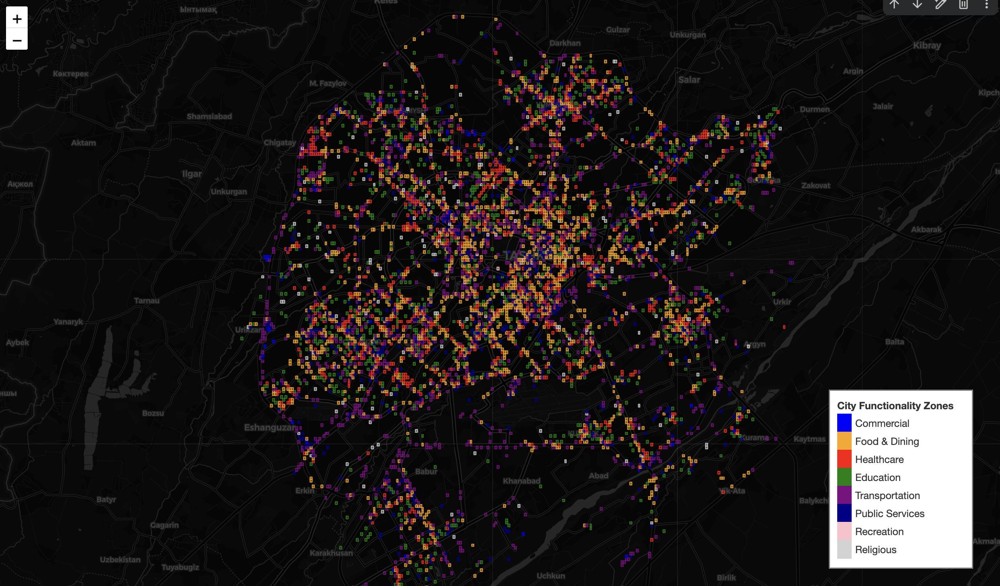